In [22]:
import torch
import torchvision.transforms as transforms
from torchvision.datasets import MNIST
import matplotlib.pyplot as plt
import numpy as np
import os
import random

# Load MNIST dataset
transform = transforms.Compose([
    transforms.Resize((28, 28)),
    transforms.ToTensor()
])
dataset = MNIST(root="./data", train=True, download=True, transform=transform)

In [23]:
def get_random_matrix(size=2):
    """Returns images (inverted) and numeric labels for a size×size random MNIST matrix."""
    indices = torch.randint(0, len(dataset), (size, size))
    matrix_images = [[1 - dataset[i][0].squeeze(0).numpy() for i in row] for row in indices]
    matrix_values = [[dataset[i][1] for i in row] for row in indices]
    return matrix_images, matrix_values

def draw_bracket(ax, x, y_bottom, y_top, side='left', bracket_width=10, linewidth=3):
    """
    Draws a single bracket at x (vertical line from y_bottom to y_top,
    plus horizontal lines at top and bottom).
    side='left' draws a bracket oriented like [ ; side='right' draws ].
    """
    if side == 'left':
        # top line goes from (x+bracket_width, y_top) to (x, y_top)
        # vertical line from (x, y_top) to (x, y_bottom)
        # bottom line from (x, y_bottom) to (x+bracket_width, y_bottom)
        lines = [
            ((x+bracket_width, y_top),   (x, y_top)),
            ((x, y_top),                 (x, y_bottom)),
            ((x, y_bottom),              (x+bracket_width, y_bottom))
        ]
    else:
        # This is the "mirrored" bracket
        lines = [
            ((x-bracket_width, y_top),   (x, y_top)),
            ((x, y_top),                 (x, y_bottom)),
            ((x, y_bottom),              (x-bracket_width, y_bottom))
        ]
    # Add each line to the plot
    for (start, end) in lines:
        ax.add_line(plt.Line2D([start[0], end[0]],
                               [start[1], end[1]],
                               color='black', linewidth=linewidth))

def draw_random_operator(ax, x_center, y_center, size=10, operator=None):
    """Draws a specified operator (+, -, or ×) centered exactly between matrices."""
    if operator is None:
        operator = random.choice(["+", "-", "×"])  # Randomly select an operator

    line_width = 2  # Thin lines for better readability

    if operator == "+":
        ax.plot([x_center - size//2, x_center + size//2], [y_center, y_center], 'k', linewidth=line_width)
        ax.plot([x_center, x_center], [y_center - size//2, y_center + size//2], 'k', linewidth=line_width)

    elif operator == "-":
        ax.plot([x_center - size//2, x_center + size//2], [y_center, y_center], 'k', linewidth=line_width)

    elif operator == "×":
        ax.plot([x_center - size//2, x_center + size//2], [y_center - size//2, y_center + size//2], 'k', linewidth=line_width)
        ax.plot([x_center - size//2, x_center + size//2], [y_center + size//2, y_center - size//2], 'k', linewidth=line_width)

    return operator  # Return the chosen operator

def plot_matrices(A_images, B_images, operator, save_path=None):
    size = len(A_images)

    cell_size       = 28   # MNIST digit size
    cell_spacing    = 6    # Small gap within matrix cells
    matrix_gap      = 50   # Increase the gap between matrices
    operator_gap    = 12
    operator_margin = 30   # Extra margin between each bracket and the operator
    bracket_width   = 10
    bracket_lw      = 3

    fig, ax = plt.subplots(figsize=(size*4, size*3))  # Wider figure
    ax.axis('off')

    def cell_extent(row, col, x_offset=0):
        left   = col * (cell_size + cell_spacing) + x_offset
        right  = left + cell_size
        top    = -row * (cell_size + cell_spacing)
        bottom = top - cell_size
        return (left, right, bottom, top)

    matrix_width  = size * (cell_size + cell_spacing) - cell_spacing
    matrix_height = size * (cell_size + cell_spacing) - cell_spacing

    # --- Plot Matrix A ---
    for i in range(size):
        for j in range(size):
            ax.imshow(A_images[i][j], cmap='gray', origin='upper',
                      extent=cell_extent(i, j, x_offset=0))

    # Brackets for Matrix A
    y_top_A, y_bot_A = 0, -matrix_height
    draw_bracket(ax, x=-12,
                 y_bottom=y_bot_A, y_top=y_top_A,
                 side='left', bracket_width=bracket_width, linewidth=bracket_lw)
    draw_bracket(ax, x=matrix_width+12,
                 y_bottom=y_bot_A, y_top=y_top_A,
                 side='right', bracket_width=bracket_width, linewidth=bracket_lw)

    # --- Plot Matrix B ---
    x_offset_B = matrix_width + matrix_gap + operator_gap
    for i in range(size):
        for j in range(size):
            ax.imshow(B_images[i][j], cmap='gray', origin='upper',
                      extent=cell_extent(i, j, x_offset=x_offset_B))

    # Brackets for Matrix B
    y_top_B, y_bot_B = 0, -matrix_height
    draw_bracket(ax, x=x_offset_B - 12,
                 y_bottom=y_bot_B, y_top=y_top_B,
                 side='left', bracket_width=bracket_width, linewidth=bracket_lw)
    draw_bracket(ax, x=x_offset_B + matrix_width + 12,
                 y_bottom=y_bot_B, y_top=y_top_B,
                 side='right', bracket_width=bracket_width, linewidth=bracket_lw)

    # --- Center the operator, but add extra margin from the brackets ---
    left_bracket_of_A  = (matrix_width + 12) + operator_margin
    right_bracket_of_B = (x_offset_B - 12) - operator_margin

    x_operator = 0.5 * (left_bracket_of_A + right_bracket_of_B)
    y_operator = -matrix_height / 2

    draw_random_operator(ax, x_operator, y_operator, size=10, operator=operator)

    ax.autoscale()

    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches="tight")
    plt.show()

def save_matrix_data(set_name, num_samples, size):
    """Generate, plot, and save matrix multiplication data with balanced operators."""
    os.makedirs(f"dataset/{set_name}/images", exist_ok=True)
    os.makedirs(f"dataset/{set_name}/matrices", exist_ok=True)

    A_matrices, B_matrices, labels, operators_list = [], [], [], []
    operators = ["+", "-", "×"]
    num_per_operator = num_samples // len(operators)  # Equal split

    for i, operator in enumerate(operators):
        for _ in range(num_per_operator):
            A_images, A_values = get_random_matrix(size)
            B_images, B_values = get_random_matrix(size)

            A_values_np = np.array(A_values)
            B_values_np = np.array(B_values)

            # Compute the correct label based on the operator
            if operator == "+":
                ground_truth = A_values_np + B_values_np
            elif operator == "-":
                ground_truth = A_values_np - B_values_np
            elif operator == "×":
                ground_truth = np.matmul(A_values_np, B_values_np)

            # Save images
            img_path = f"dataset/{set_name}/images/{size}x{size}_{operator}_{i}.png"
            plot_matrices(A_images, B_images, operator, save_path=img_path)

            # Store matrices, labels, and operator
            A_matrices.append(A_values_np)
            B_matrices.append(B_values_np)
            labels.append(ground_truth)
            operators_list.append(operator)

    # Save all data
    np.save(f"dataset/{set_name}/matrices/A_{size}x{size}.npy", np.array(A_matrices))
    np.save(f"dataset/{set_name}/matrices/B_{size}x{size}.npy", np.array(B_matrices))
    np.save(f"dataset/{set_name}/labels_{size}x{size}.npy", np.array(labels))
    np.save(f"dataset/{set_name}/operators_{size}x{size}.npy", np.array(operators_list))  # Store operator info

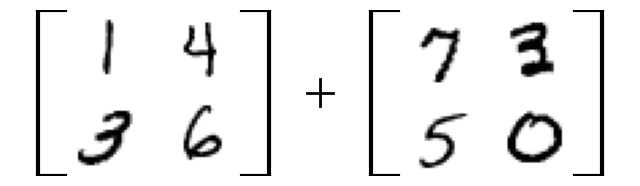

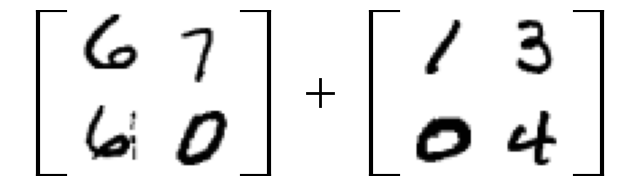

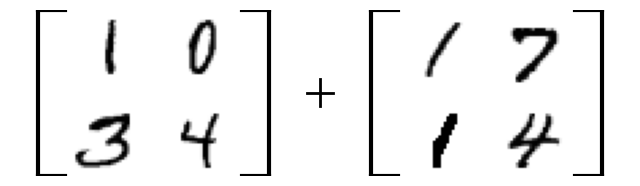

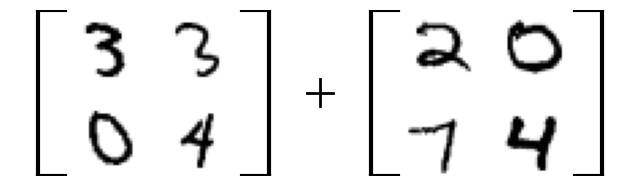

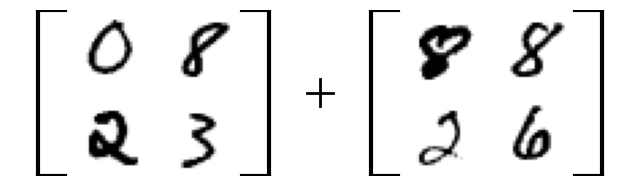

...

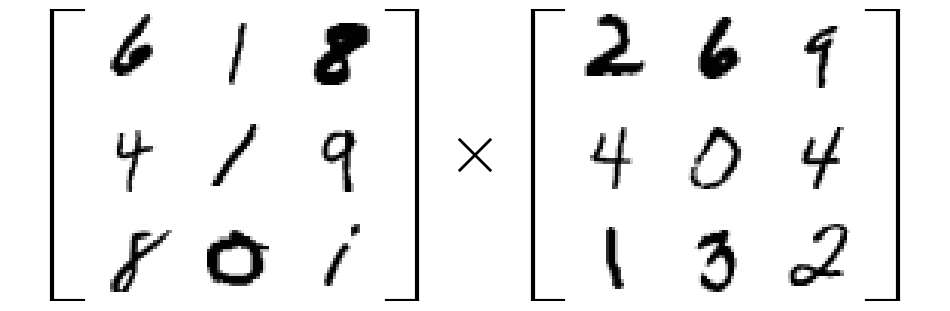

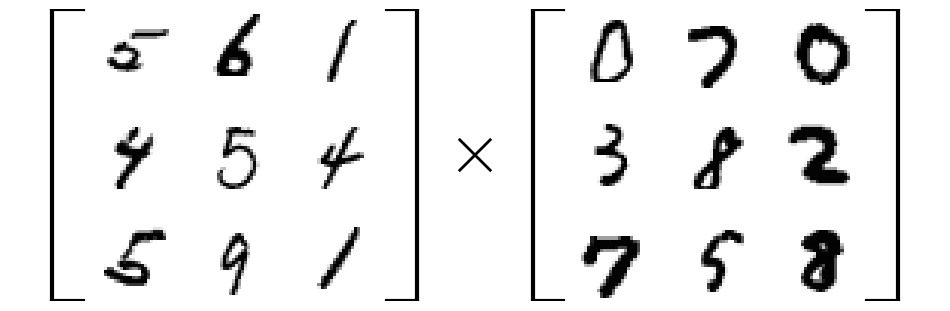

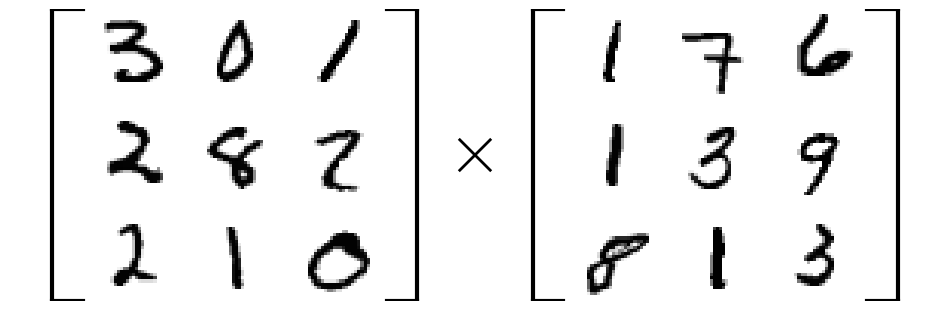

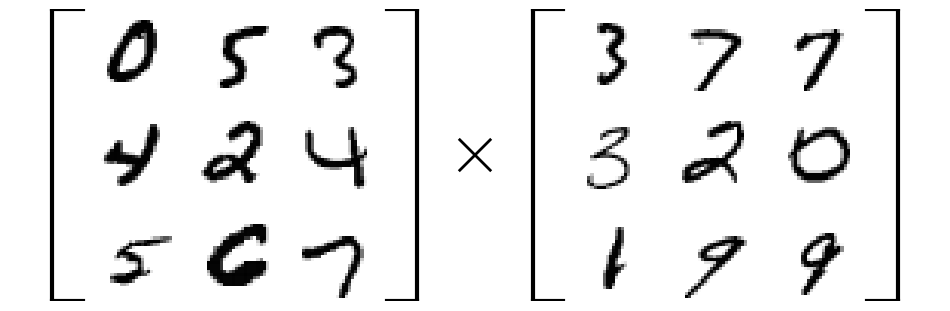

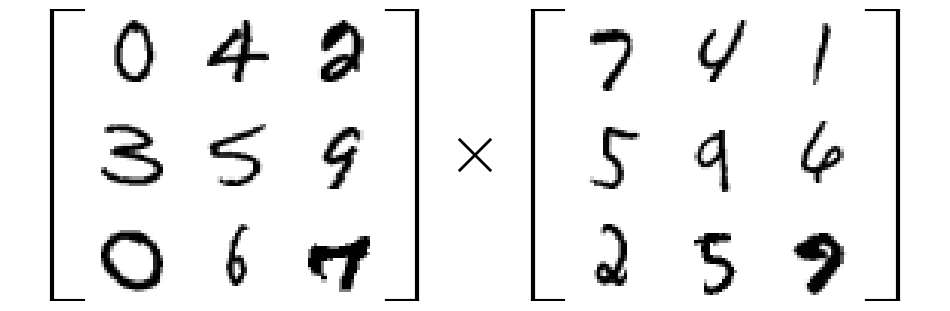

Balanced dataset generation complete!


In [24]:
# Generate dataset with balanced operators
sizes = [2, 3]
dataset_splits = {"train": 400, "val": 50, "test": 50}

for split, num_samples in dataset_splits.items():
    for size in sizes:
        save_matrix_data(split, num_samples, size)

print("Balanced dataset generation complete!")

In [25]:
dataA = np.load("/content/dataset/test/matrices/A_2x2.npy")
print(dataA)

[[[9 7]
  [9 8]]

 [[8 1]
  [6 5]]

 [[4 7]
  [5 4]]

 [[9 0]
  [8 9]]

 [[5 6]
  [9 7]]

 [[8 9]
  [4 7]]

 [[2 2]
  [0 2]]

 [[8 1]
  [7 2]]

 [[2 4]
  [2 8]]

 [[8 5]
  [5 7]]

 [[3 0]
  [7 0]]

 [[0 2]
  [4 3]]

 [[8 1]
  [7 4]]

 [[8 1]
  [1 1]]

 [[5 4]
  [9 7]]

 [[5 5]
  [7 3]]

 [[2 9]
  [8 7]]

 [[4 9]
  [4 3]]

 [[3 5]
  [4 1]]

 [[9 6]
  [9 4]]

 [[7 0]
  [4 9]]

 [[7 2]
  [6 2]]

 [[5 4]
  [4 9]]

 [[5 3]
  [8 5]]

 [[6 3]
  [1 6]]

 [[4 1]
  [2 6]]

 [[0 3]
  [1 6]]

 [[8 1]
  [8 3]]

 [[7 1]
  [8 8]]

 [[4 6]
  [4 5]]

 [[6 1]
  [4 9]]

 [[6 7]
  [0 3]]

 [[2 7]
  [7 6]]

 [[7 7]
  [1 4]]

 [[6 9]
  [2 3]]

 [[1 2]
  [6 7]]

 [[6 4]
  [1 3]]

 [[7 1]
  [0 4]]

 [[0 7]
  [8 7]]

 [[8 5]
  [9 2]]

 [[6 1]
  [3 2]]

 [[3 3]
  [4 0]]

 [[7 1]
  [0 1]]

 [[3 1]
  [8 1]]

 [[1 1]
  [0 6]]

 [[4 6]
  [3 9]]

 [[2 1]
  [7 3]]

 [[2 7]
  [8 3]]]


In [26]:
dataB = np.load("/content/dataset/test/matrices/B_2x2.npy")
print(dataB)

[[[0 2]
  [7 3]]

 [[2 0]
  [0 6]]

 [[0 2]
  [5 0]]

 [[4 0]
  [7 2]]

 [[2 5]
  [5 4]]

 [[4 2]
  [6 9]]

 [[5 3]
  [9 1]]

 [[4 0]
  [0 2]]

 [[5 5]
  [9 1]]

 [[0 7]
  [1 2]]

 [[1 1]
  [4 1]]

 [[3 6]
  [3 8]]

 [[2 1]
  [4 4]]

 [[7 4]
  [9 6]]

 [[2 0]
  [4 7]]

 [[9 9]
  [4 6]]

 [[6 7]
  [2 5]]

 [[1 2]
  [6 4]]

 [[1 6]
  [6 9]]

 [[8 3]
  [9 5]]

 [[7 0]
  [9 0]]

 [[0 3]
  [9 4]]

 [[1 2]
  [1 0]]

 [[2 9]
  [7 6]]

 [[6 3]
  [2 7]]

 [[4 4]
  [7 4]]

 [[7 9]
  [9 1]]

 [[6 7]
  [8 7]]

 [[2 1]
  [2 6]]

 [[3 3]
  [7 4]]

 [[2 2]
  [9 8]]

 [[5 7]
  [4 4]]

 [[5 7]
  [7 8]]

 [[3 5]
  [4 6]]

 [[7 7]
  [5 3]]

 [[3 6]
  [9 1]]

 [[4 5]
  [9 6]]

 [[2 7]
  [7 1]]

 [[0 8]
  [5 3]]

 [[8 2]
  [7 9]]

 [[4 2]
  [3 0]]

 [[7 5]
  [1 1]]

 [[9 4]
  [8 8]]

 [[9 9]
  [9 3]]

 [[1 2]
  [8 2]]

 [[8 3]
  [5 8]]

 [[1 3]
  [7 7]]

 [[5 8]
  [8 2]]]


In [27]:
dataOp = np.load("/content/dataset/test/operators_2x2.npy")
print(dataOp)

['+' '+' '+' '+' '+' '+' '+' '+' '+' '+' '+' '+' '+' '+' '+' '+' '-' '-'
 '-' '-' '-' '-' '-' '-' '-' '-' '-' '-' '-' '-' '-' '-' '×' '×' '×' '×'
 '×' '×' '×' '×' '×' '×' '×' '×' '×' '×' '×' '×']


In [29]:
dataC = np.load("/content/dataset/test/labels_2x2.npy")
print(dataC)

[[[ 9  9]
  [16 11]]

 [[10  1]
  [ 6 11]]

 [[ 4  9]
  [10  4]]

 [[13  0]
  [15 11]]

 [[ 7 11]
  [14 11]]

 [[12 11]
  [10 16]]

 [[ 7  5]
  [ 9  3]]

 [[12  1]
  [ 7  4]]

 [[ 7  9]
  [11  9]]

 [[ 8 12]
  [ 6  9]]

 [[ 4  1]
  [11  1]]

 [[ 3  8]
  [ 7 11]]

 [[10  2]
  [11  8]]

 [[15  5]
  [10  7]]

 [[ 7  4]
  [13 14]]

 [[14 14]
  [11  9]]

 [[-4  2]
  [ 6  2]]

 [[ 3  7]
  [-2 -1]]

 [[ 2 -1]
  [-2 -8]]

 [[ 1  3]
  [ 0 -1]]

 [[ 0  0]
  [-5  9]]

 [[ 7 -1]
  [-3 -2]]

 [[ 4  2]
  [ 3  9]]

 [[ 3 -6]
  [ 1 -1]]

 [[ 0  0]
  [-1 -1]]

 [[ 0 -3]
  [-5  2]]

 [[-7 -6]
  [-8  5]]

 [[ 2 -6]
  [ 0 -4]]

 [[ 5  0]
  [ 6  2]]

 [[ 1  3]
  [-3  1]]

 [[ 4 -1]
  [-5  1]]

 [[ 1  0]
  [-4 -1]]

 [[59 70]
  [77 97]]

 [[49 77]
  [19 29]]

 [[87 69]
  [29 23]]

 [[21  8]
  [81 43]]

 [[60 54]
  [31 23]]

 [[21 50]
  [28  4]]

 [[35 21]
  [35 85]]

 [[99 61]
  [86 36]]

 [[27 12]
  [18  6]]

 [[24 18]
  [28 20]]

 [[71 36]
  [ 8  8]]

 [[36 30]
  [81 75]]

 [[ 9  4]
  [48 12]]

 [[62 60]


In [30]:
!zip -r /content/dataset.zip /content/dataset/

  adding: content/dataset/ (stored 0%)
  adding: content/dataset/val/ (stored 0%)
  adding: content/dataset/val/operators_3x3.npy (deflated 75%)
  adding: content/dataset/val/matrices/ (stored 0%)
  adding: content/dataset/val/matrices/A_2x2.npy (deflated 82%)
  adding: content/dataset/val/matrices/B_3x3.npy (deflated 86%)
  adding: content/dataset/val/matrices/A_3x3.npy (deflated 86%)
  adding: content/dataset/val/matrices/B_2x2.npy (deflated 82%)
  adding: content/dataset/val/labels_2x2.npy (deflated 77%)
  adding: content/dataset/val/operators_2x2.npy (deflated 75%)
  adding: content/dataset/val/labels_3x3.npy (deflated 80%)
  adding: content/dataset/val/images/ (stored 0%)
  adding: content/dataset/val/images/3x3_+_0.png (deflated 49%)
  adding: content/dataset/val/images/3x3_×_2.png (deflated 46%)
  adding: content/dataset/val/images/2x2_×_2.png (deflated 41%)
  adding: content/dataset/val/images/3x3_-_1.png (deflated 50%)
  adding: content/dataset/val/images/2x2_+_0.png (deflated

In [31]:
from google.colab import files
files.download("/content/dataset.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>